# Homework 7
# Yuxin Sun
------------------------------

## Real Data

Figure 1

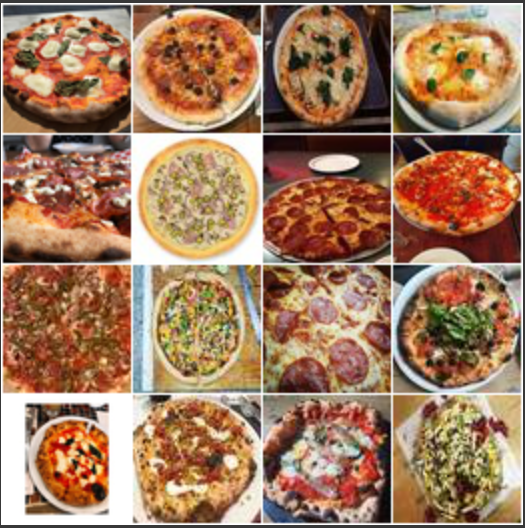

## Results



### BCEGAN

parameters: $ l_r = 2.5\times10^{-4}, \beta_1=0.5, \beta_2=0.99$ and `batch_size=32`.

Figure 2

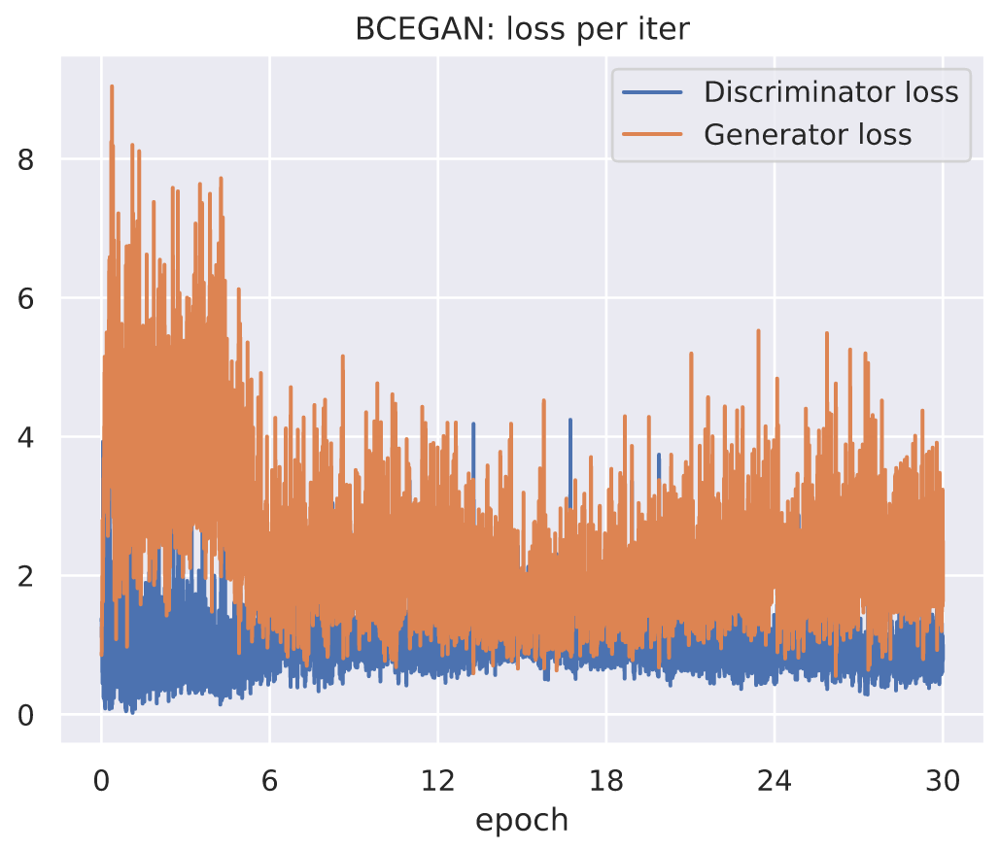

Figure 3

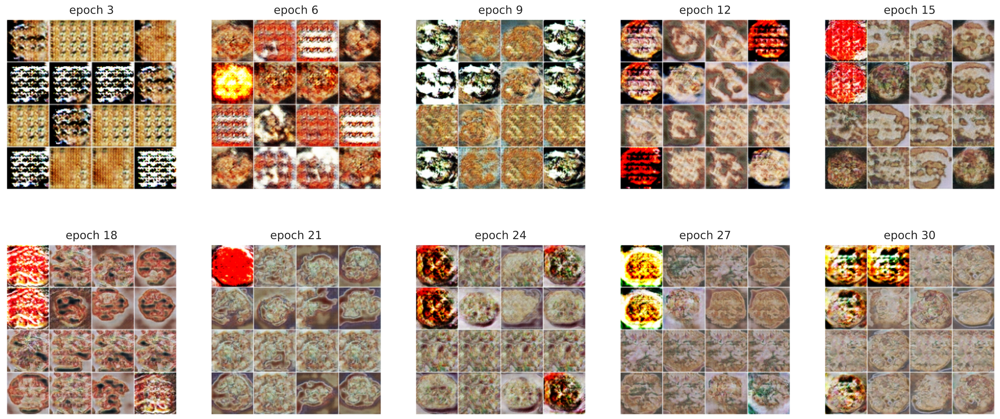

Figure 4

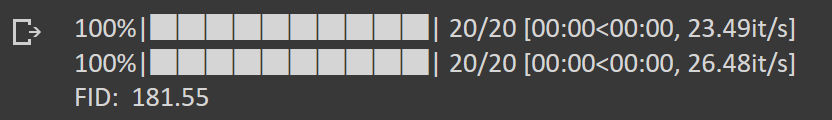

Above fake images looks like pizza, but their contrast ratio is too low.


### WGAN

parameters: $ l_r = 7\times10^{-5}, \beta_1=0.05, \beta_2=0.9$, `LAMBDA=16`, `ncritic=3` and `batch_size=32`

Train once with $60$ epochs:

Figure 5

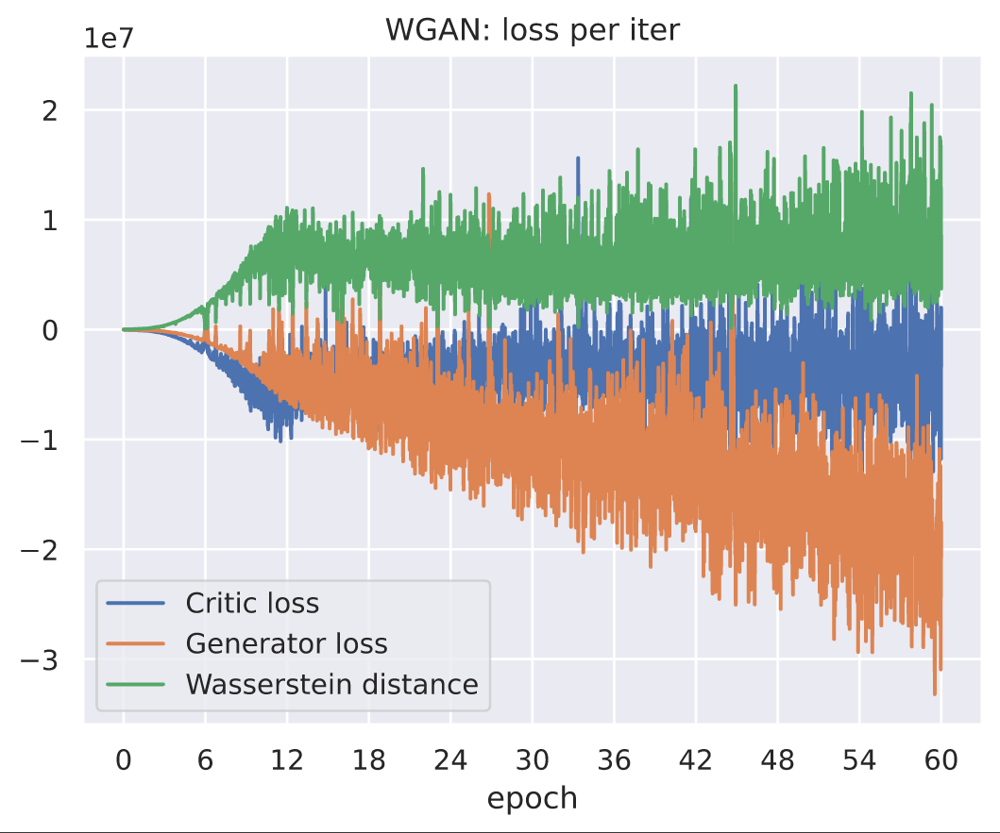

Figure 6

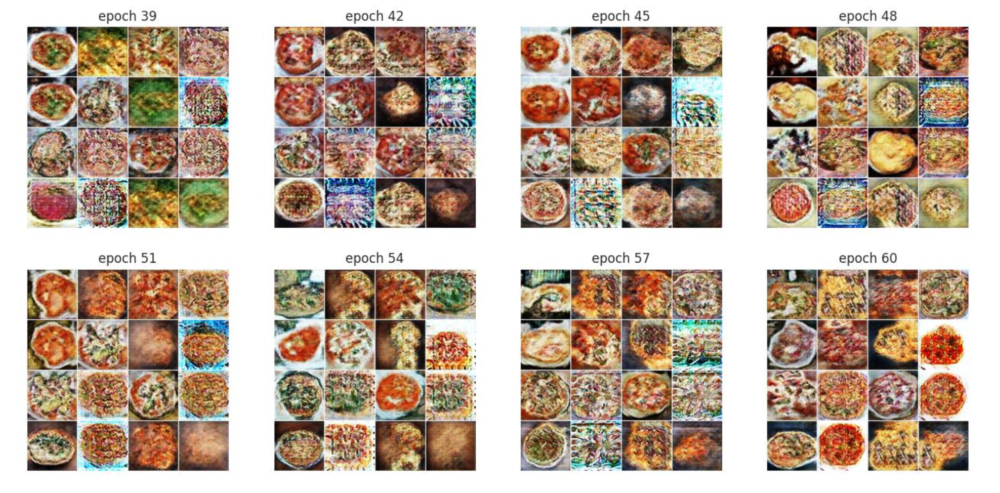

Figure 7

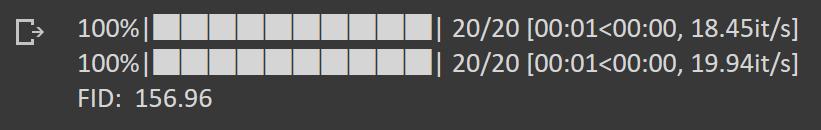


#### Should the Generator loss converge?

Another way to train WGAN: After 27 epochs, reset the Adam optimizer and train another 27 epochs. In this way the Generator loss will probably converge.

Results are as follows:

Figure 8 (Left: Second 27-epoch training.)

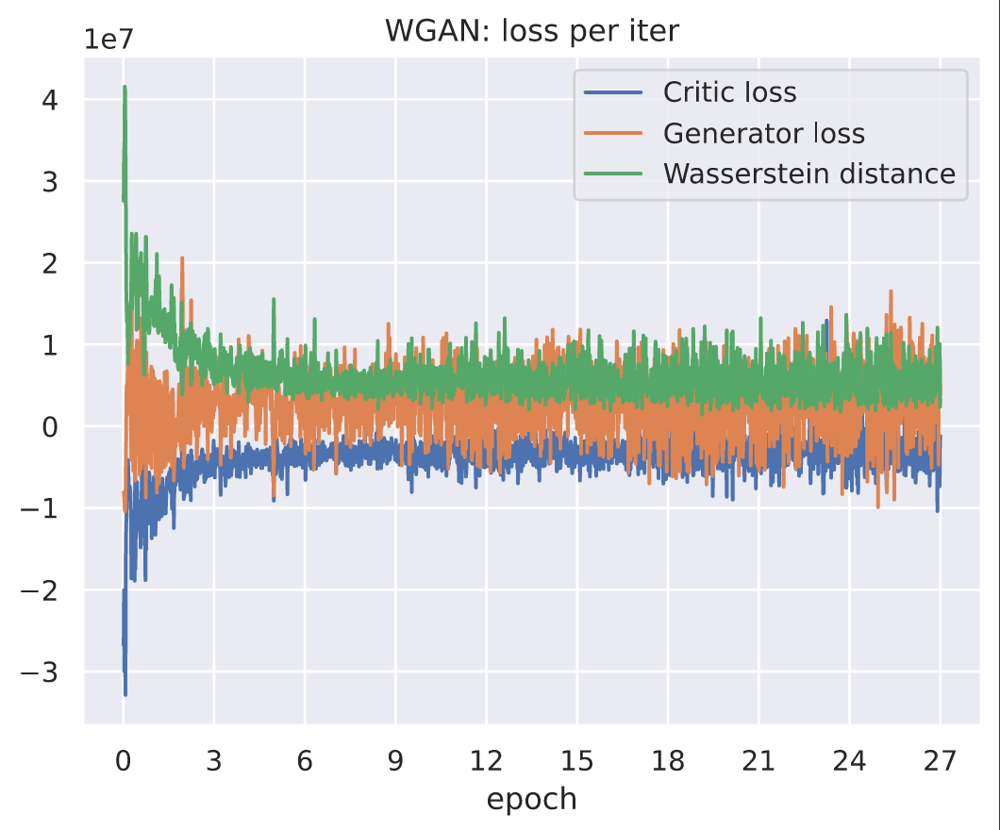

Figure 9

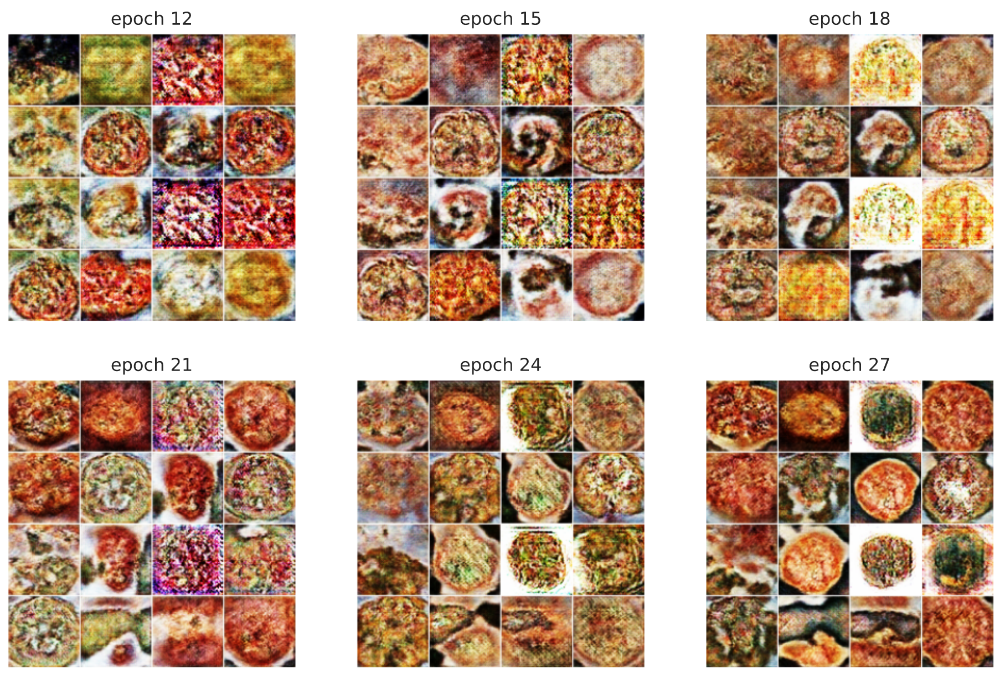

Figure 10

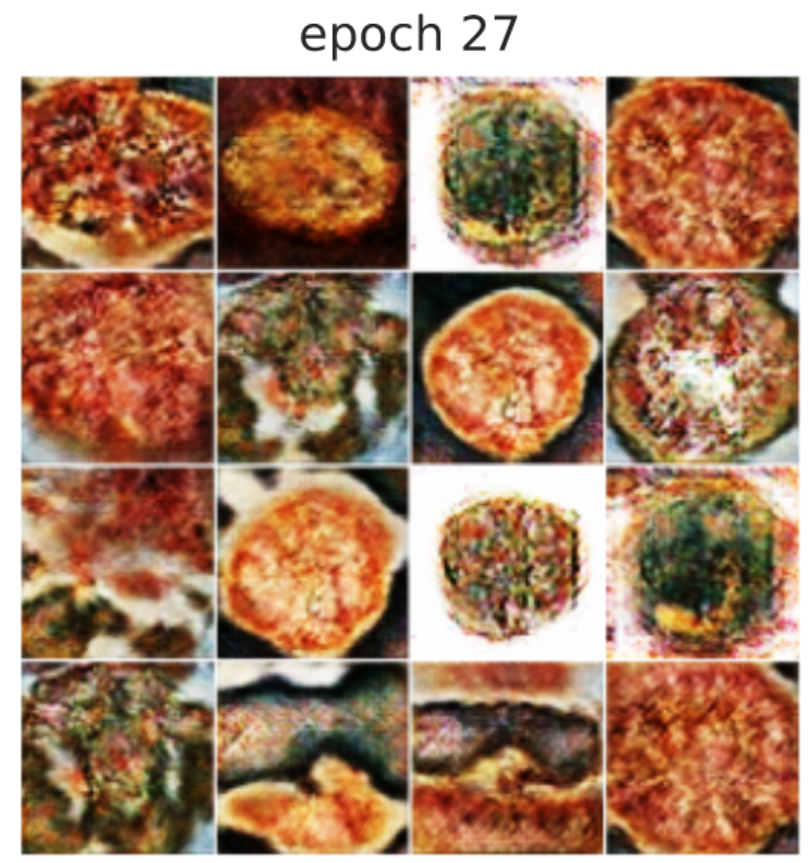

Figure 11

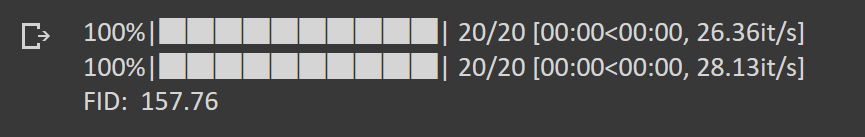



In both case the Wasserstein distance converges to approximately $6\times10^6$





## BCEGAN vs. WGAN

I feel that WGAN performs better than BCEGAN, and it is easier to get good results.

The reason may be that WGAN uses a differenciable distance function, so it can avoid some cases that gradient descent is not possible.

Besides, I apply gradient-panelty to WGAN, but use no optimization on original BCEGAN. This difference may also makes WGAN outperform BCEGAN.


## Code

I will present part of my code in this section.

### SkipBlocks
I use `SkipBlock` in both Generator and Discriminator nets.

There are `SkipBlockUP` modules in Generator , and I use `BatchNorm2d` for normalization.

In `SkipBlockDN`, I replace `BatchNorm2d` with `InstanceNorm2d` to avoid in-batch interference of images. This is the requirement of gradient-penalty method for the Critic.

```python
class SkipBlockDN(nn.Module):
    def __init__(self, in_ch, out_ch, ker=4, *, stride=2, padding=1) -> None:
        super(SkipBlockDN, self).__init__()
        self.in_ch = in_ch
        self.out_ch = out_ch
        self.stride = stride
        self.conv1 = nn.Conv2d(in_ch, out_ch, ker, stride=stride, padding=padding, bias=False)
        self.conv2 = nn.Conv2d(out_ch, out_ch, 3, stride=1, padding=1, bias=False)
        self.bn1 = nn.InstanceNorm2d(out_ch)
        self.bn2 = nn.InstanceNorm2d(out_ch)
        self.relu = nn.LeakyReLU(0.1, inplace=True)
        downsampler = []
        if stride != 1:
            if stride != 2:
                raise ValueError('Currently stride must be 1 or 2.')
            downsampler.append(nn.AvgPool2d(2,2))
        if in_ch != out_ch:
            downsampler.extend([
                nn.Conv2d(in_ch, out_ch, 1, stride=1, padding=0, bias=False, 
                        #   groups=in_ch//4
                ),
                nn.InstanceNorm2d(out_ch)
            ])
        if downsampler != []:
            self.downsampler = nn.Sequential(*downsampler)
        else:
            self.downsampler = None

    def forward(self, x):
        identity = x

        out = self.conv1(x)
        out = self.bn1(out)
        out = self.relu(out)
        out = self.conv2(out)
        out = self.bn2(out)
        if self.downsampler is not None:
            identity = self.downsampler(identity)

        out = out + identity
        out = self.relu(out)

        return out
    

class SkipBlockUP(nn.Module):
    def __init__(self, in_ch, out_ch, ker=4, *, stride=2, padding=1) -> None:
        super(SkipBlockUP, self).__init__()
        self.in_ch = in_ch
        self.out_ch = out_ch
        self.stride = stride
        self.convT1 = nn.ConvTranspose2d(in_ch, in_ch,    3, stride=1, padding=1, bias=False)
        self.convT2 = nn.ConvTranspose2d(in_ch, out_ch, ker, stride=stride, padding=padding, bias=False)
        self.bn1 = nn.BatchNorm2d(in_ch)
        self.bn2 = nn.BatchNorm2d(out_ch)
        self.relu = nn.LeakyReLU(0.1, inplace=True)
        upsampler = []
        if in_ch != out_ch:
            upsampler.extend([
                nn.ConvTranspose2d(in_ch, out_ch, 1, stride=1, padding=0, bias=False, 
                                #    groups=out_ch//4
                ),
                nn.BatchNorm2d(out_ch)
            ])
        if stride != 1:
            if stride != 2:
                raise ValueError('Currently stride must be 1 or 2.')
            upsampler.append(nn.Upsample(scale_factor=stride))
        if upsampler != []:
            self.upsampler = nn.Sequential(*upsampler)
        else:
            self.upsampler = None

    def forward(self, x):
        identity = x

        out = self.convT1(x)
        out = self.bn1(out)
        out = self.relu(out)
        out = self.convT2(out)
        out = self.bn2(out)
        if self.upsampler is not None:
            identity = self.upsampler(identity)

        out = out + identity
        out = self.relu(out)

        return out
```

### Generator and Discriminator

The Generator and Discriminator and highly symmetric. We can regard one net as the reversed version of the other one.

```python
class Generator(nn.Module):
    def __init__(self):
        super().__init__()
        model = [
            nn.Linear(100, 64),
            nn.LeakyReLU(0.1, True),
            nn.Linear(64,  128),
            nn.LeakyReLU(0.1, True),
            nn.Linear(128,  512),
            nn.LeakyReLU(0.1, True),
            nn.Linear(512, 4096),
            nn.LeakyReLU(0.1, True),
            nn.Unflatten(1, (256,4,4)),
            SkipBlockUP(256,256, ker=4, stride=2, padding=1),
            SkipBlockUP(256,256, ker=4, stride=2, padding=1),
            SkipBlockUP(256,128, ker=4, stride=2, padding=1),
            SkipBlockUP(128,128, ker=4, stride=2, padding=1),
            nn.ConvTranspose2d(128, 3, 3, stride=1, padding=1, bias=True),
            nn.Tanh(),
        ]
        self.model = nn.Sequential(*model)

    def forward(self, x):
        out = self.model(x)
        return(out)

class NetD(nn.Module):
    def __init__(self):
        super().__init__()
        model = [
            nn.Conv2d(    3, 128,     5, stride=1, padding=2, bias=False),
            nn.LeakyReLU(0.1, inplace=True),
            SkipBlockDN(128, 128, ker=4, stride=2, padding=1),
            SkipBlockDN(128, 256, ker=4, stride=2, padding=1),
            SkipBlockDN(256, 256, ker=4, stride=2, padding=1),
            SkipBlockDN(256, 256, ker=4, stride=2, padding=1),
            nn.Flatten(),
            nn.Linear(4096, 512),
            nn.LeakyReLU(0.1, inplace=True),
            nn.Linear(512, 128),
            nn.LeakyReLU(0.1, inplace=True),
            nn.Linear(128, 64),
            nn.LeakyReLU(0.1, inplace=True),
            nn.Linear(64,  1),
        ]
        self.model = nn.Sequential(*model)

class Discriminator(NetD):
    def __init__(self):
        super().__init__()
        # super(NetD, self).__init__()


    def forward(self, x):
        out = self.model(x)
        out = torch.sigmoid(out)
        return out

class Critic(NetD):
    def __init__(self):
        # super(NetD, self).__init__()
        super().__init__()
    
    def forward(self, x):
        out = self.model(x)
        out = out.mean(0)
        out = out.view(1)
        return out
```